<a href="https://colab.research.google.com/github/monanjo123/keras-transfer-learning/blob/master/Keras_Transfer_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
import math
import numpy as np
import pandas as pd
import json
from matplotlib import pyplot as plt
import tensorflow as tf
from keras.applications import MobileNetV2, VGG16
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten, GlobalAveragePooling2D
from keras.layers import Conv2D, MaxPooling2D, ZeroPadding2D
from keras.layers.normalization import BatchNormalization
from keras.models import Model
from keras.preprocessing.image import ImageDataGenerator
import zipfile
from keras.optimizers import RMSprop
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from keras.models import load_model
from google.colab.patches import cv2_imshow
import tarfile

Using TensorFlow backend.


# Monkey Classifier with MobilenetV2

In [2]:
# MobileNet was designed to work on 224 x 224 pixel input images sizes
img_row, img_cols = 224, 224

# Re-loads the MobileNet model without the top or FC layers
MobileNet = MobileNetV2(weights='imagenet',
                         include_top=False,
                         input_shape= (img_row, img_cols, 3))

# Freeze the last 4 layers
for layer in MobileNet.layers:
  layer.trainable = False
  
# Print layers
for (i,layer) in enumerate(MobileNet.layers):
    print(str(i) + " "+ layer.__class__.__name__, layer.trainable)







9412608/9406464 [==============================] - 2s 0us/step
0 InputLayer False
1 ZeroPadding2D False
2 Conv2D False
3 BatchNormalization False
4 ReLU False
5 DepthwiseConv2D False
6 BatchNormalization False
7 ReLU False
8 Conv2D False
9 BatchNormalization False
10 Conv2D False
11 BatchNormalization False
12 ReLU False
13 ZeroPadding2D False
14 DepthwiseConv2D False
15 BatchNormalization False
16 ReLU False
17 Conv2D False
18 BatchNormalization False
19 Conv2D False
20 BatchNormalization False
21 ReLU False
22 DepthwiseConv2D False
23 BatchNormalization False
24 ReLU False
25 Conv2D False
26 BatchNormalization False
27 Add False
28 Conv2D False
29 BatchNormalization False
30 ReLU False
31 ZeroPadding2D False
32 DepthwiseConv2D False
33 BatchNormalization False
34 ReLU False
35 Conv2D False
36 BatchNormalization False
37 Conv2D False
38 BatchNormalization False
39 ReLU False
40 DepthwiseConv2D False
41 BatchNormalization False
42 ReLU False
43 Conv2D False
44 BatchNormalization 

### Let's make a function that returns our FC Head

In [0]:
def addTopModelMobileNet(bottom_model, num_classes):
  """creates the top or head of the model that will be 
    placed ontop of the bottom layers"""
  
  top_model = bottom_model.output
  top_model = GlobalAveragePooling2D()(top_model)
  top_model = Dense(1024, activation='relu')(top_model)
  top_model = Dense(1024, activation='relu')(top_model)  
  top_model = Dense(512, activation='relu')(top_model)
  top_model = Dense(num_classes, activation='softmax')(top_model)    
  return top_model

### Let's add our FC Head back onto MobileNet

In [4]:
# 10 num_classes since we're predicting 10 species
num_classes = 10

FC_Head = addTopModelMobileNet(MobileNet, num_classes)

model = Model(inputs = MobileNet.input, outputs = FC_Head)

print(model.summary())

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 224, 224, 3)  0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 225, 225, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
____________________________________________________________________________________________

# Load Dataset

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
# unzip dataset zip file
local_zip = '/content/drive/My Drive/Machine Learning/datasets/monkey_breed.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall("/content/drive/My Drive/Machine Learning/datasets/")
zip_ref.close()

In [7]:
train_data_dir = "/content/drive/My Drive/Machine Learning/datasets/monkey_breed/train"
validation_data_dir = "/content/drive/My Drive/Machine Learning/datasets/monkey_breed/validation"


# Let's use some data augmentaiton 
train_datagen = ImageDataGenerator(
      rescale=1./255,
      rotation_range=45,
      width_shift_range=0.3,
      height_shift_range=0.3,
      horizontal_flip=True,
      fill_mode='nearest')
 
validation_datagen = ImageDataGenerator(rescale=1./255)
 
# set our batch size (typically on most mid tier systems we'll use 16-32)
batch_size = 32
 
train_generator = train_datagen.flow_from_directory(
        train_data_dir,
        target_size=(img_row, img_cols),
        batch_size=batch_size,
        class_mode='categorical')
 
validation_generator = validation_datagen.flow_from_directory(
        validation_data_dir,
        target_size=(img_row, img_cols),
        batch_size=batch_size,
        class_mode='categorical')

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


# Train Model

In [8]:
checkpoint = ModelCheckpoint("/content/drive/My Drive/Machine Learning/Models/monkey_breed_mobileNet.h5",
                             monitor="val_loss",
                             mode="min",
                             save_best_only = True,
                             verbose=1)

earlystop = EarlyStopping(monitor = 'val_loss', 
                          min_delta = 0, 
                          patience = 5,
                          verbose = 1,
                          restore_best_weights = True)

# we put our call backs into a callback list
callbacks = [earlystop, checkpoint]

# We use a very small learning rate 
model.compile(loss = 'categorical_crossentropy',
              optimizer = RMSprop(lr = 0.001),
              metrics = ['accuracy'])

# Enter the number of training and validation samples here
nb_train_samples = 1097
nb_validation_samples = 272

# We only train 5 EPOCHS 
epochs = 25
batch_size = 16

history = model.fit_generator(
    train_generator,
    steps_per_epoch = nb_train_samples // batch_size,
    epochs = epochs,
    callbacks = callbacks,
    validation_data = validation_generator,
    validation_steps = nb_validation_samples // batch_size)


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Epoch 1/25
68/68 [==============================] - 100s 1s/step - loss: 1.6174 - acc: 0.5581 - val_loss: 0.6561 - val_acc: 0.8087

Epoch 00001: val_loss improved from inf to 0.65613, saving model to /content/drive/My Drive/Machine Learning/Models/monkey_breed_mobileNet.h5
Epoch 2/25
68/68 [==============================] - 97s 1s/step - loss: 0.5998 - acc: 0.8124 - val_loss: 0.9265 - val_acc: 0.8262

Epoch 00002: val_loss did not improve from 0.65613
Epoch 3/25
68/68 [==============================] - 94s 1s/step - loss: 0.4768 - acc: 0.8545 - val_loss: 0.6090 - val_acc: 0.8516

Epoch 00003: val_loss improved from 0.65613 to 0.60900, saving model to /content/drive/My Drive/Machine Learning/Models/monkey_breed_mobileNet.h5
Epoch 4/25
68/68 [==============================] - 95s 1s/step - loss: 0.4334 - acc: 0.8743 - val_loss: 0.8362 - val_acc: 0.8555

Epoch 00004: val_loss did not improve fro

# Test our Classifier

Class - japanese_macaque


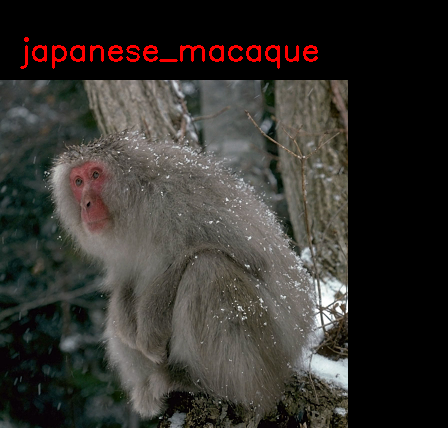

Class - nilgiri_langur


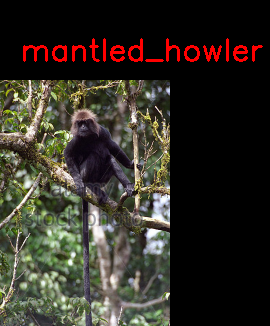

Class - patas_monkey


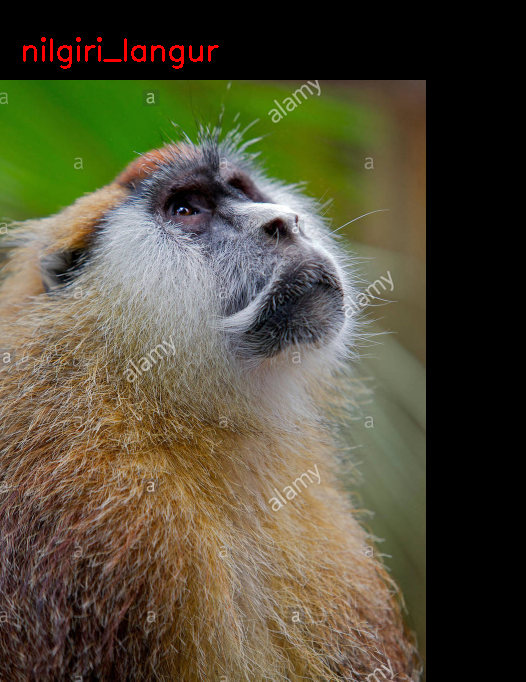

Class - common_squirrel_monkey


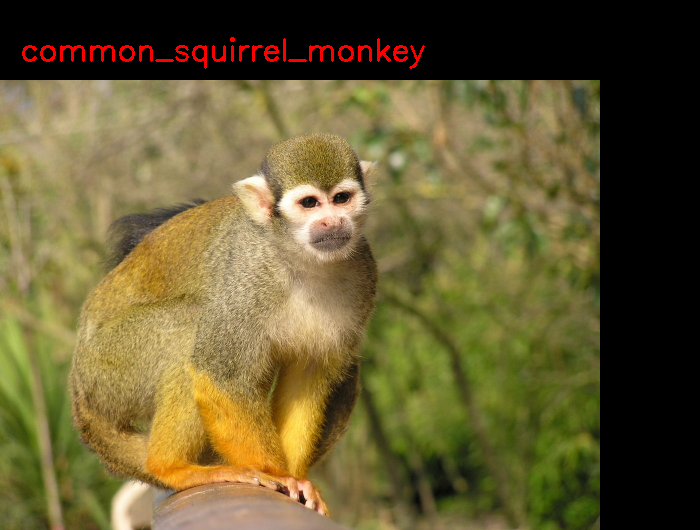

Class - white_headed_capuchin


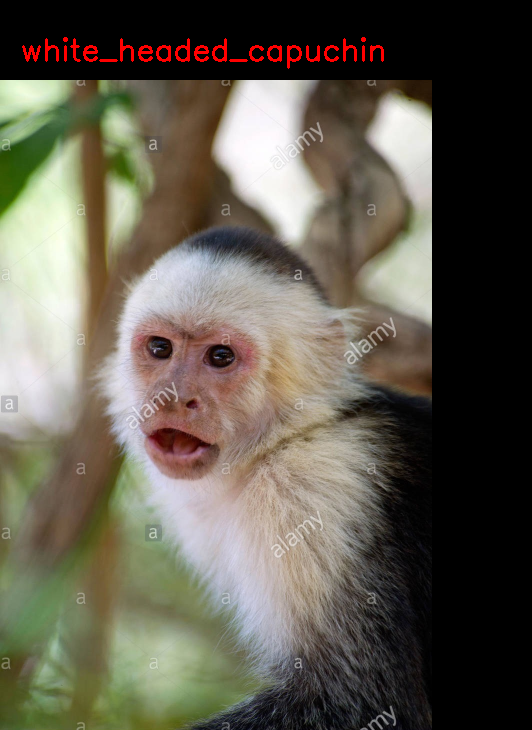

Class - japanese_macaque


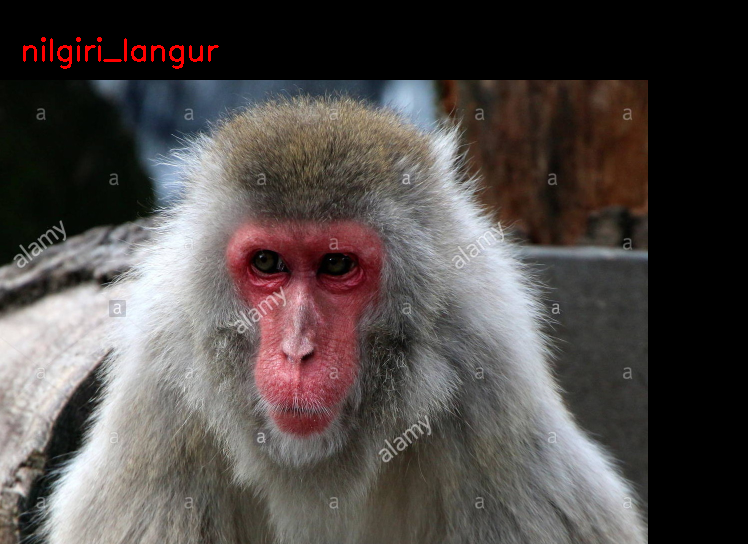

Class - common_squirrel_monkey


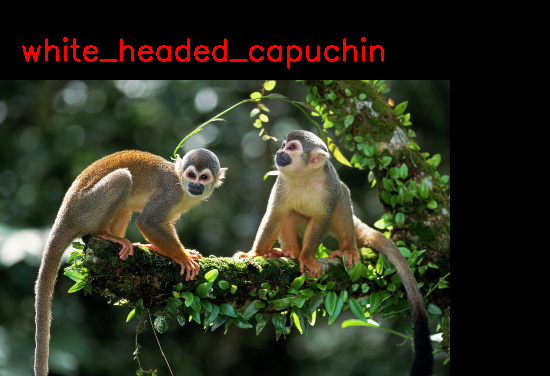

Class - mantled_howler 


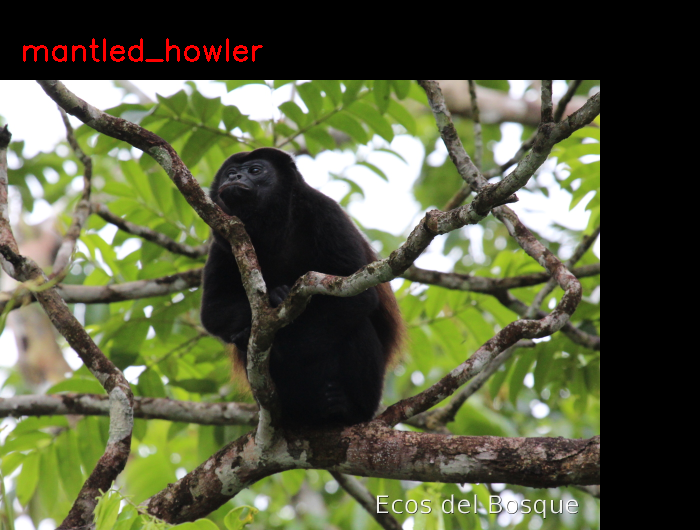

Class - mantled_howler 


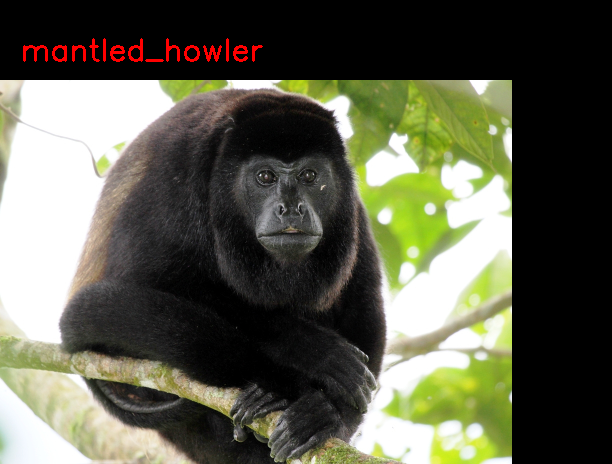

Class - silvery_marmoset


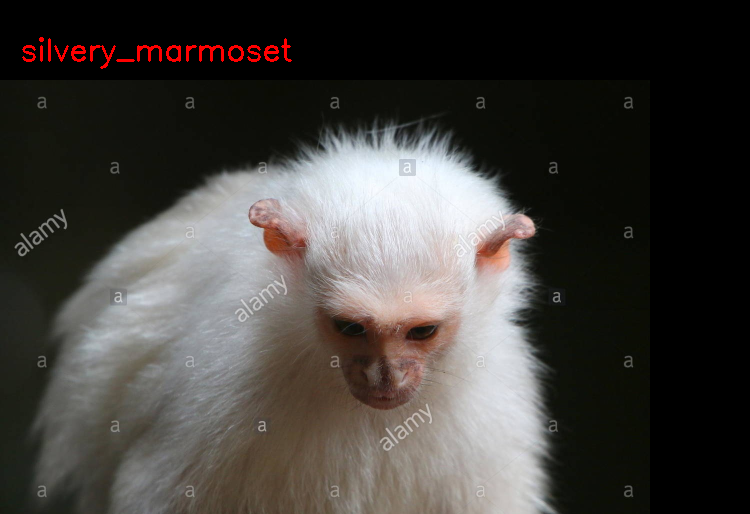

Class - common_squirrel_monkey


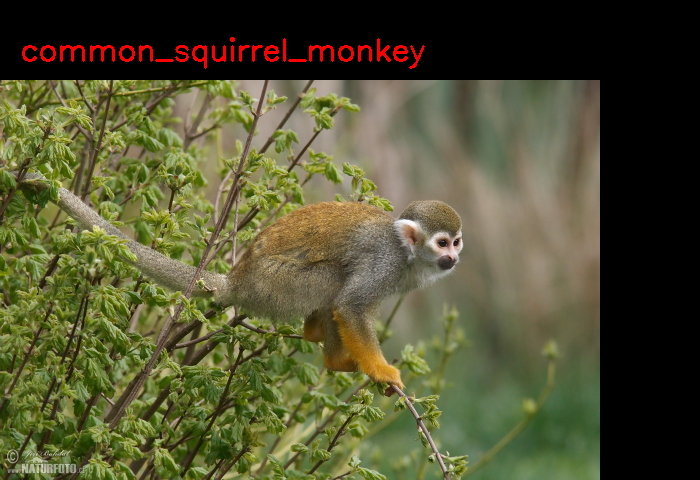

Class - japanese_macaque


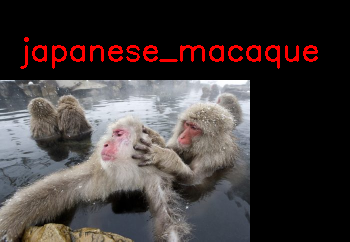

Class - mantled_howler 


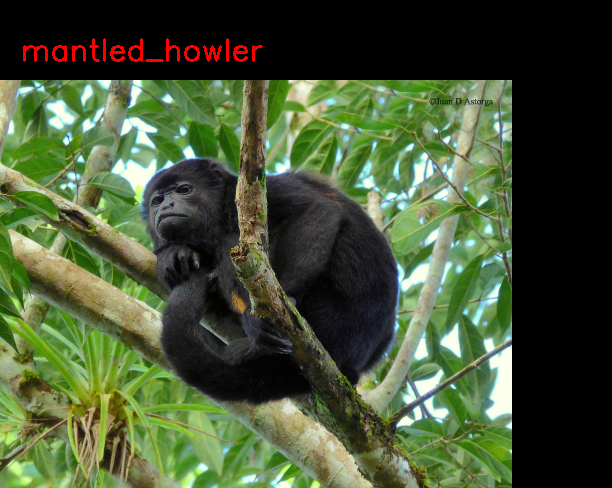

Class - nilgiri_langur


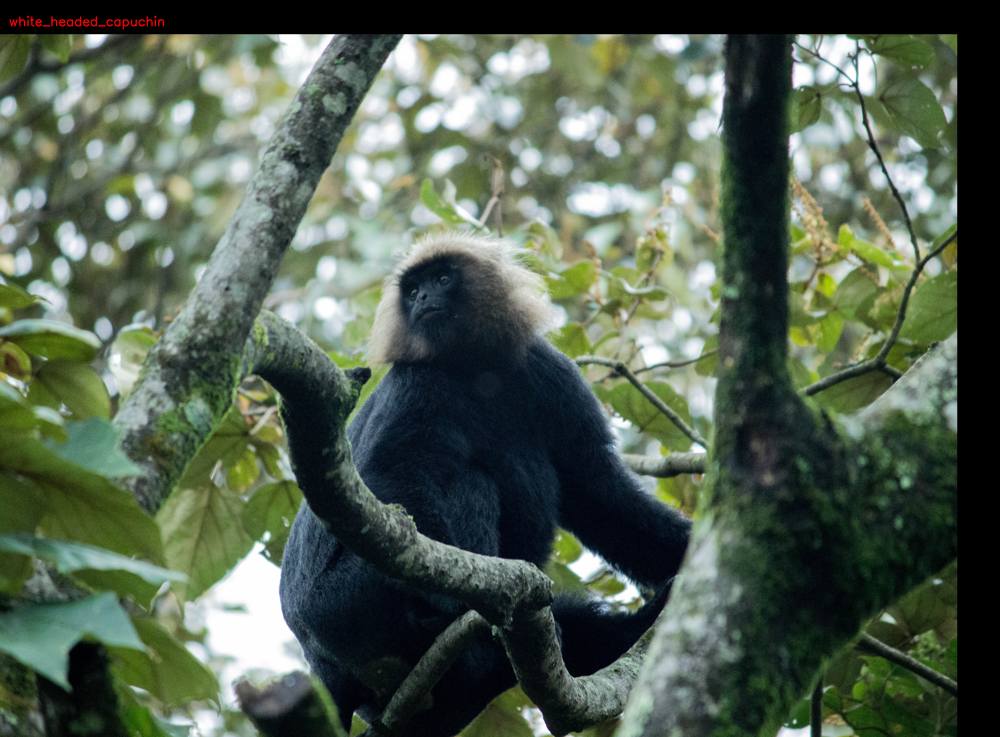

Class - black_headed_night_monkey


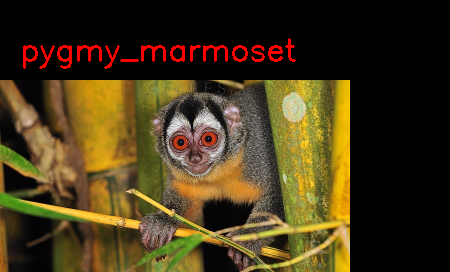

Class - nilgiri_langur


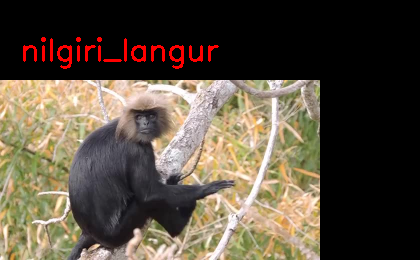

Class - common_squirrel_monkey


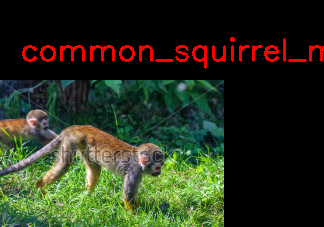

Class - patas_monkey


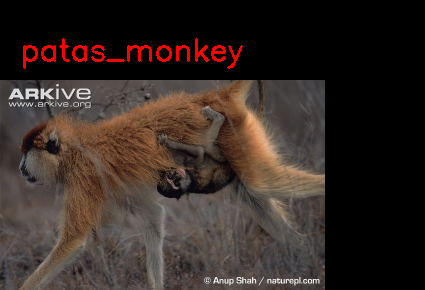

Class - mantled_howler 


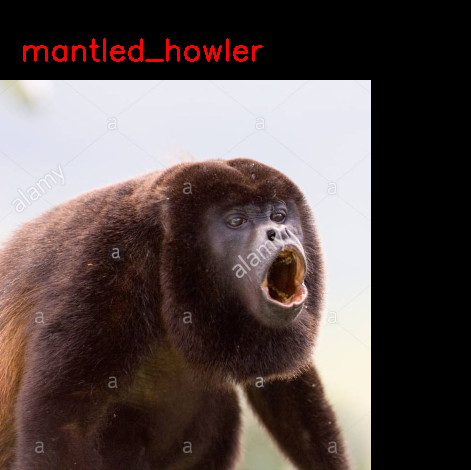

Class - black_headed_night_monkey


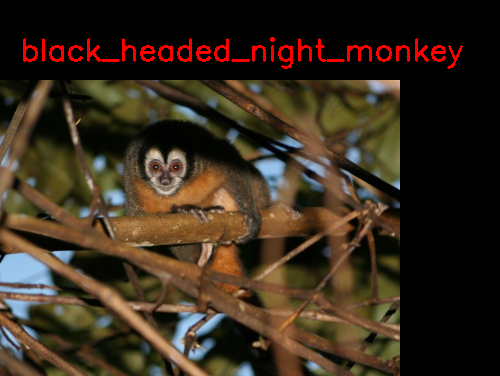

In [9]:
# Load Model
classifier = load_model('/content/drive/My Drive/Machine Learning/Models/monkey_breed_mobileNet.h5')

monkey_breeds_dict = {"[0]": "mantled_howler ", 
                      "[1]": "patas_monkey",
                      "[2]": "bald_uakari",
                      "[3]": "japanese_macaque",
                      "[4]": "pygmy_marmoset ",
                      "[5]": "white_headed_capuchin",
                      "[6]": "silvery_marmoset",
                      "[7]": "common_squirrel_monkey",
                      "[8]": "black_headed_night_monkey",
                      "[9]": "nilgiri_langur"}

monkey_breeds_dict_n = {"n0": "mantled_howler ", 
                      "n1": "patas_monkey",
                      "n2": "bald_uakari",
                      "n3": "japanese_macaque",
                      "n4": "pygmy_marmoset ",
                      "n5": "white_headed_capuchin",
                      "n6": "silvery_marmoset",
                      "n7": "common_squirrel_monkey",
                      "n8": "black_headed_night_monkey",
                      "n9": "nilgiri_langur"}

def draw_test(name, pred, im):
    monkey = monkey_breeds_dict[str(pred)]
    BLACK = [0,0,0]
    expanded_image = cv2.copyMakeBorder(im, 80, 0, 0, 100 ,cv2.BORDER_CONSTANT,value=BLACK)
    cv2.putText(expanded_image, monkey, (20, 60) , cv2.FONT_HERSHEY_SIMPLEX,1, (0,0,255), 2)
    cv2_imshow(expanded_image)

def getRandomImage(path):
    """function loads a random images from a random folder in our test path """
    folders = list(filter(lambda x: os.path.isdir(os.path.join(path, x)), os.listdir(path)))
    random_directory = np.random.randint(0,len(folders))
    path_class = folders[random_directory]
    print("Class - " + monkey_breeds_dict_n[str(path_class)])
    file_path = path + path_class
    file_names = [f for f in listdir(file_path) if isfile(join(file_path, f))]
    random_file_index = np.random.randint(0,len(file_names))
    image_name = file_names[random_file_index]
    return cv2.imread(file_path+"/"+image_name)


for i in range(0,20):
    input_im = getRandomImage(validation_data_dir + '/')
    input_original = input_im.copy()
    input_original = cv2.resize(input_original, None, fx=0.5, fy=0.5, interpolation = cv2.INTER_LINEAR)
    
    input_im = cv2.resize(input_im, (224, 224), interpolation = cv2.INTER_LINEAR)
    input_im = input_im / 255.
    input_im = input_im.reshape(1,224,224,3) 
    
    # Get Prediction
    res = np.argmax(classifier.predict(input_im, 1, verbose = 0), axis=1)
    
    # Show image with predicted class
    draw_test("Prediction", res, input_original)

# Flower Classifier with VGG16

In [10]:
# VGG16 was designed to work on 224 x 224 pixel input images sizes
img_rows, img_cols = 224, 224

# Re-loads the MobileNet model without the top or FC layers
vgg = VGG16(weights='imagenet',
                         include_top=False,
                         input_shape= (img_rows, img_cols, 3))

# Freeze the last 4 layers
for layer in vgg.layers:
  layer.trainable = False
  
# Print layers
for (i,layer) in enumerate(vgg.layers):
    print(str(i) + " "+ layer.__class__.__name__, layer.trainable)


58892288/58889256 [==============================] - 5s 0us/step
0 InputLayer False
1 Conv2D False
2 Conv2D False
3 MaxPooling2D False
4 Conv2D False
5 Conv2D False
6 MaxPooling2D False
7 Conv2D False
8 Conv2D False
9 Conv2D False
10 MaxPooling2D False
11 Conv2D False
12 Conv2D False
13 Conv2D False
14 MaxPooling2D False
15 Conv2D False
16 Conv2D False
17 Conv2D False
18 MaxPooling2D False


In [0]:
def addTopModelVGG16(bottom_model, num_classes, D=256):
  """creates the top or head of the model that will be 
    placed ontop of the bottom layers"""
  
  top_model = bottom_model.output
  top_model = Flatten(name='flatten')(top_model)
  top_model = Dense(D, activation='relu')(top_model)
  top_model = Dropout(0.3)(top_model)
  top_model = Dense(num_classes, activation='softmax')(top_model)    
  return top_model

In [12]:
# Add FC Head to VGG

num_classes = 17

FC_head = addTopModelVGG16(vgg, num_classes)

model = Model(inputs=vgg.input, outputs=FC_head)

print(model.summary())

Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
__________

In [0]:
# unzip dataset zip file
tar = tarfile.open("/content/drive/My Drive/Machine Learning/datasets/17_flowers.tar.gz")
tar.extractall("/content/drive/My Drive/Machine Learning/datasets/")
tar.close()

In [14]:
# Load our dataset

train_data_dir = "/content/drive/My Drive/Machine Learning/datasets/17_flowers/train"
validation_data_dir = "/content/drive/My Drive/Machine Learning/datasets/17_flowers/validation"


# Let's use some data augmentaiton 
train_datagen = ImageDataGenerator(
      rescale=1./255,
      rotation_range=45,
      width_shift_range=0.3,
      height_shift_range=0.3,
      horizontal_flip=True,
      fill_mode='nearest')
 
validation_datagen = ImageDataGenerator(rescale=1./255)
 
# set our batch size (typically on most mid tier systems we'll use 16-32)
batch_size = 32
 
train_generator = train_datagen.flow_from_directory(
        train_data_dir,
        target_size=(img_rows, img_cols),
        batch_size=batch_size,
        class_mode='categorical')
 
validation_generator = validation_datagen.flow_from_directory(
        validation_data_dir,
        target_size=(img_rows, img_cols),
        batch_size=batch_size,
        class_mode='categorical')

Found 1190 images belonging to 17 classes.
Found 170 images belonging to 17 classes.


In [15]:
checkpoint = ModelCheckpoint("/content/drive/My Drive/Machine Learning/Models/flowers_vgg_16.h5",
                             monitor="val_loss",
                             mode="min",
                             save_best_only = True,
                             verbose=1)

earlystop = EarlyStopping(monitor = 'val_loss', 
                          min_delta = 0, 
                          patience = 5,
                          verbose = 1,
                          restore_best_weights = True)

reduce_lr = ReduceLROnPlateau(monitor = 'val_loss',
                              factor = 0.2,
                              patience = 3,
                              verbose = 1,
                              min_delta = 0.00001)

# we put our call backs into a callback list
callbacks = [earlystop, checkpoint, reduce_lr]

# Note we use a very small learning rate 
model.compile(loss = 'categorical_crossentropy',
              optimizer = RMSprop(lr = 0.0001),
              metrics = ['accuracy'])

nb_train_samples = 1190
nb_validation_samples = 170
epochs = 25
batch_size = 32

history = model.fit_generator(
    train_generator,
    steps_per_epoch = nb_train_samples // batch_size,
    epochs = epochs,
    callbacks = callbacks,
    validation_data = validation_generator,
    validation_steps = nb_validation_samples // batch_size)

Epoch 1/25
37/37 [==============================] - 29s 780ms/step - loss: 2.5678 - acc: 0.2028 - val_loss: 1.7572 - val_acc: 0.4875

Epoch 00001: val_loss improved from inf to 1.75721, saving model to /content/drive/My Drive/Machine Learning/Models/flowers_vgg_16.h5
Epoch 2/25
37/37 [==============================] - 26s 711ms/step - loss: 1.9710 - acc: 0.3900 - val_loss: 1.1940 - val_acc: 0.7029

Epoch 00002: val_loss improved from 1.75721 to 1.19396, saving model to /content/drive/My Drive/Machine Learning/Models/flowers_vgg_16.h5
Epoch 3/25
37/37 [==============================] - 24s 659ms/step - loss: 1.5774 - acc: 0.5294 - val_loss: 1.0771 - val_acc: 0.6957

Epoch 00003: val_loss improved from 1.19396 to 1.07707, saving model to /content/drive/My Drive/Machine Learning/Models/flowers_vgg_16.h5
Epoch 4/25
37/37 [==============================] - 24s 651ms/step - loss: 1.3913 - acc: 0.5703 - val_loss: 0.9178 - val_acc: 0.7609

Epoch 00004: val_loss improved from 1.07707 to 0.91780

{'[0]': 'bluebell', '[1]': 'buttercup', '[2]': 'colts_foot', '[3]': 'cowslip', '[4]': 'crocus', '[5]': 'daffodil', '[6]': 'daisy', '[7]': 'dandelion', '[8]': 'fritillary', '[9]': 'iris', '[10]': 'lily_valley', '[11]': 'pansy', '[12]': 'snowdrop', '[13]': 'sunflower', '[14]': 'tigerlily', '[15]': 'tulip', '[16]': 'windflower'}
Class - crocus


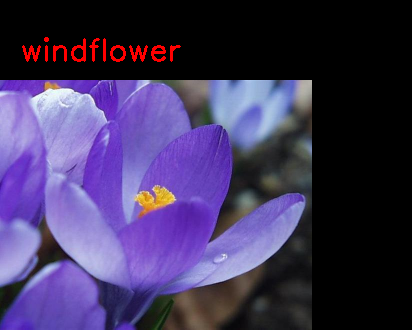

Class - snowdrop


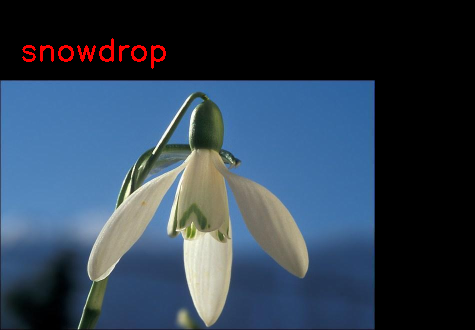

Class - daisy


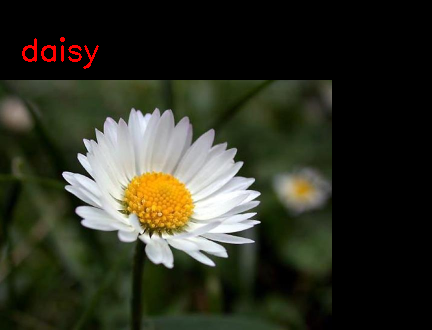

Class - lily_valley


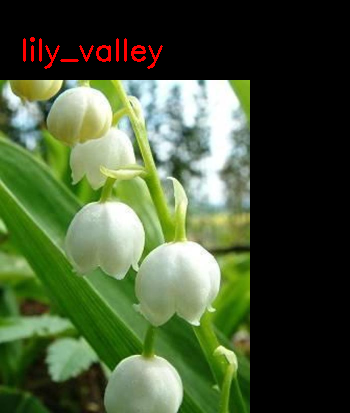

Class - daffodil


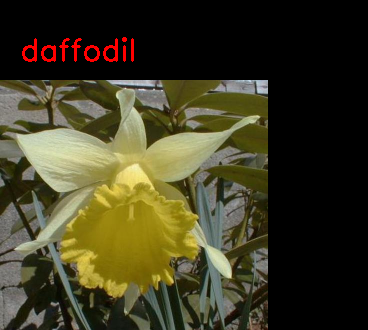

Class - buttercup


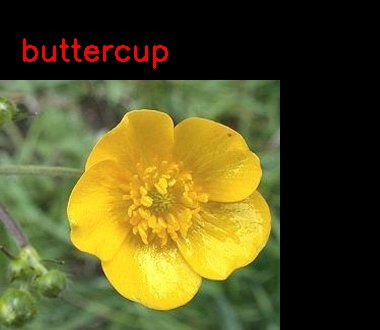

Class - snowdrop


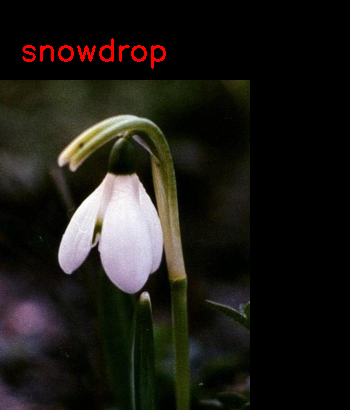

Class - tulip


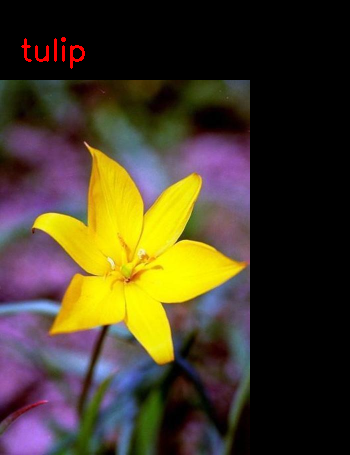

Class - daffodil


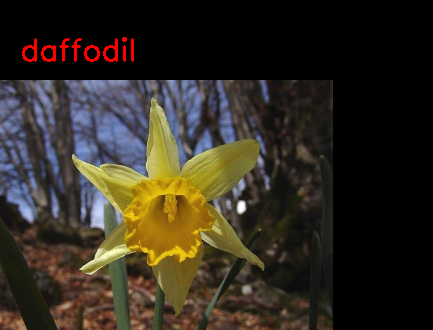

Class - daisy


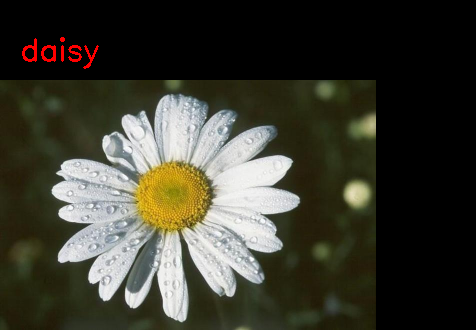

Class - buttercup


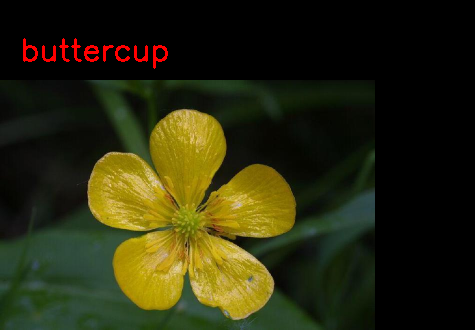

Class - crocus


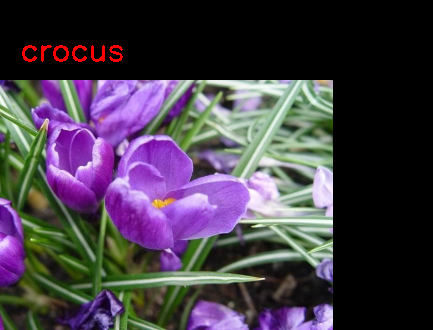

Class - bluebell


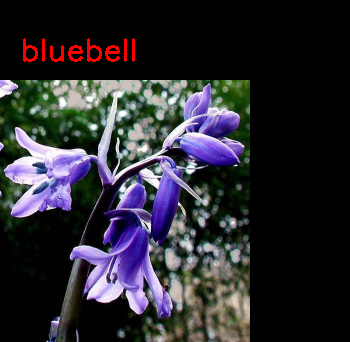

Class - iris


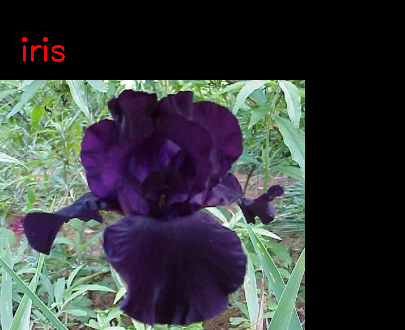

Class - buttercup


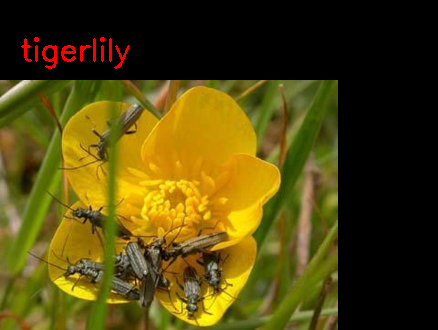

Class - daffodil


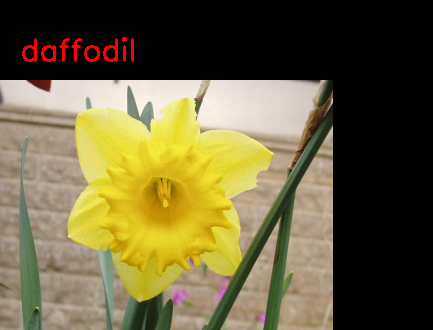

Class - daisy


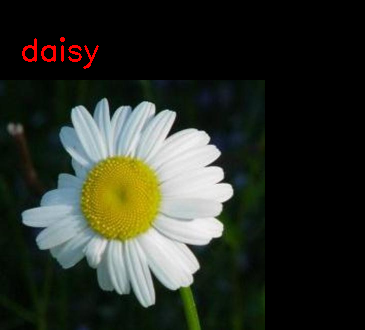

Class - snowdrop


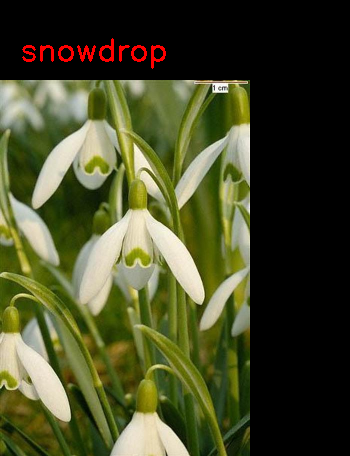

Class - dandelion


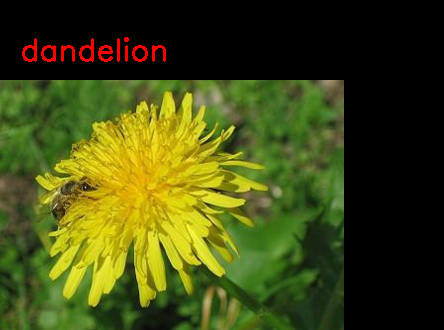

Class - daisy


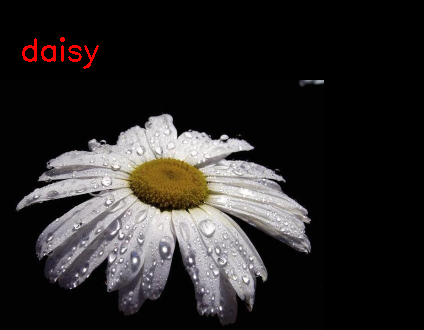

Class - bluebell


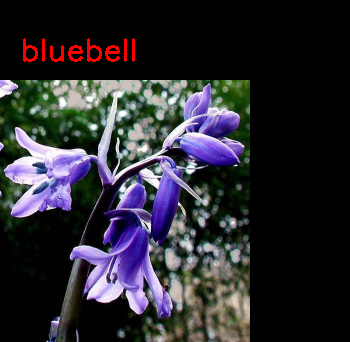

Class - bluebell


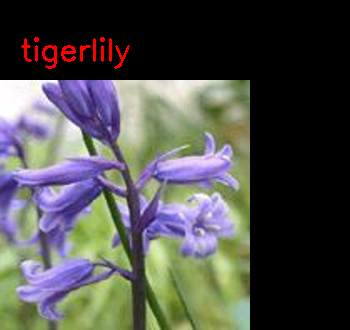

Class - tigerlily


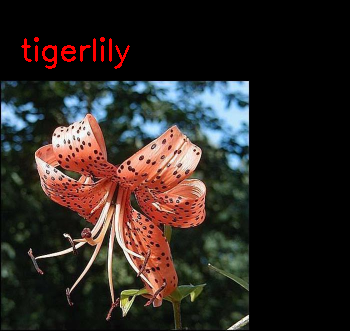

Class - snowdrop


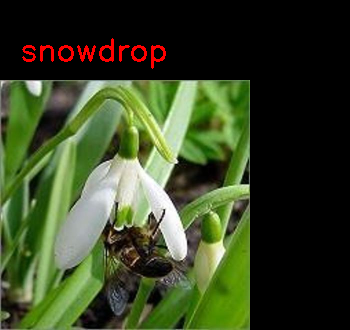

Class - dandelion


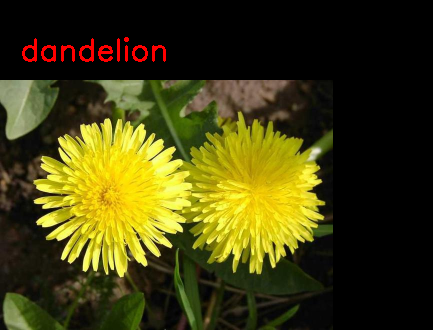

Class - bluebell


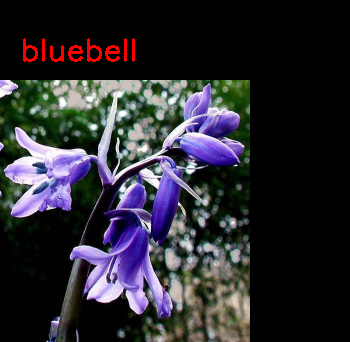

Class - buttercup


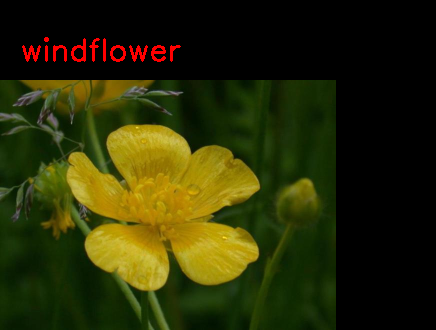

Class - tigerlily


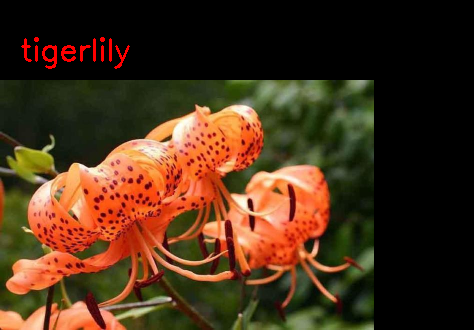

Class - buttercup


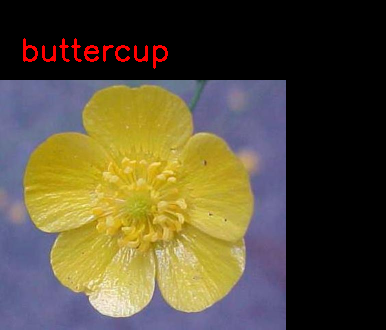

Class - pansy


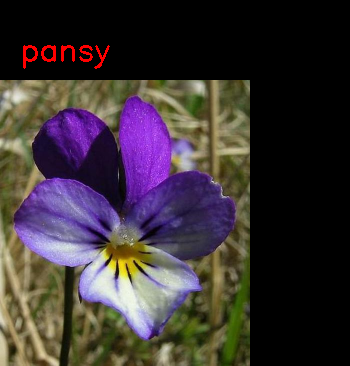

Class - buttercup


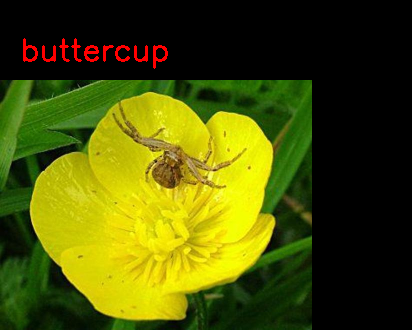

Class - dandelion


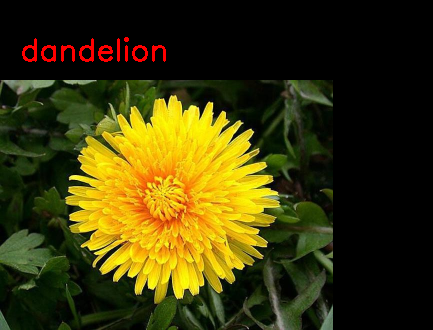

Class - snowdrop


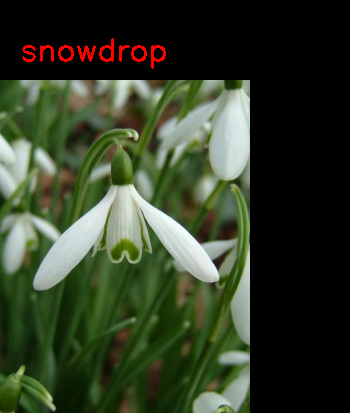

Class - daisy


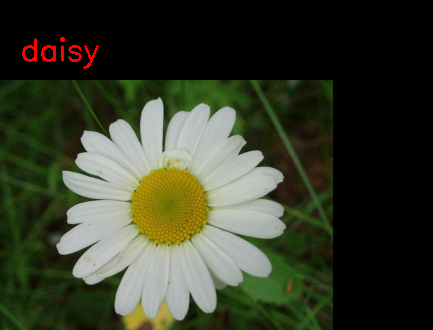

Class - pansy


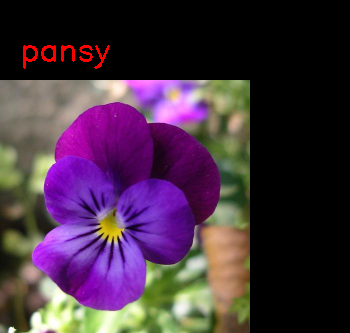

Class - snowdrop


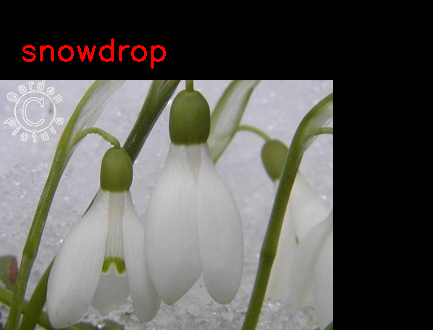

Class - snowdrop


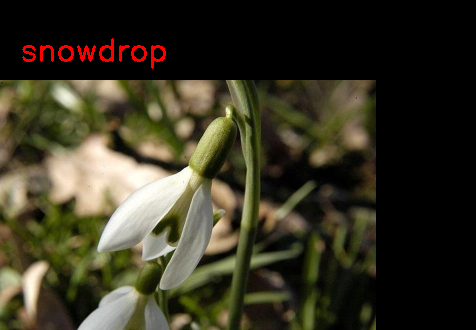

Class - tigerlily


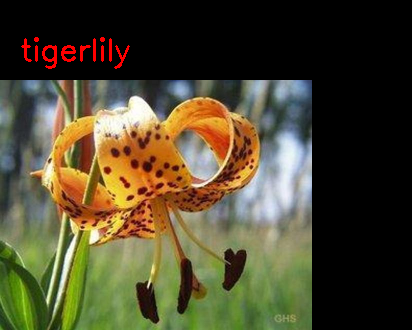

Class - daffodil


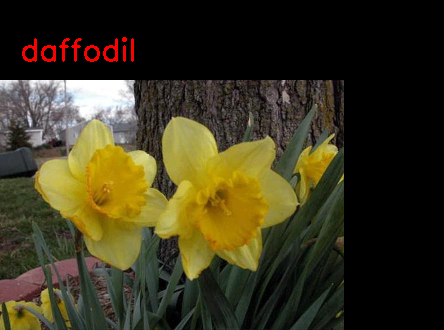

Class - sunflower


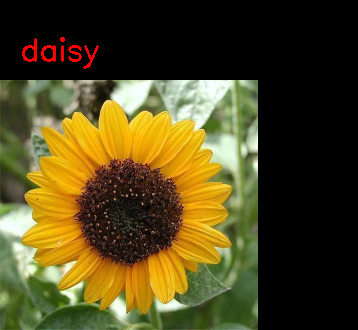

Class - windflower


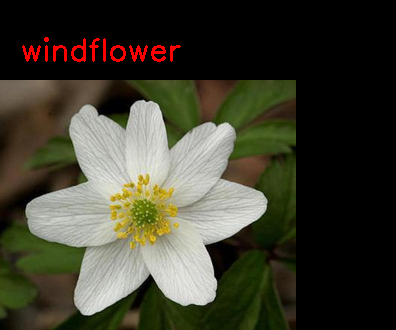

Class - daisy


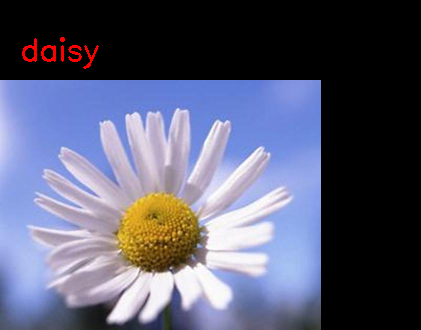

Class - colts_foot


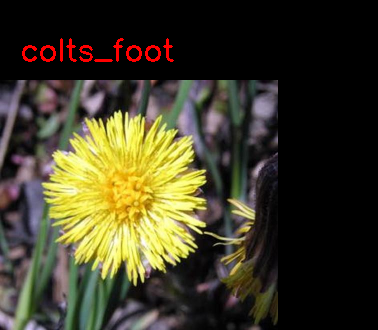

Class - crocus


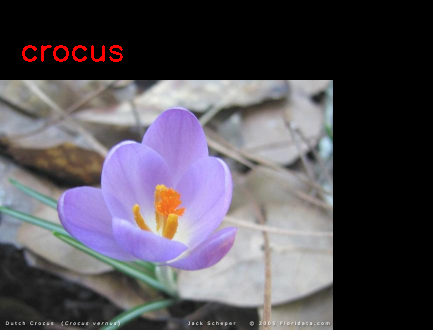

Class - cowslip


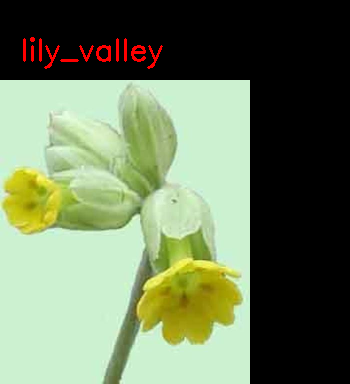

Class - cowslip


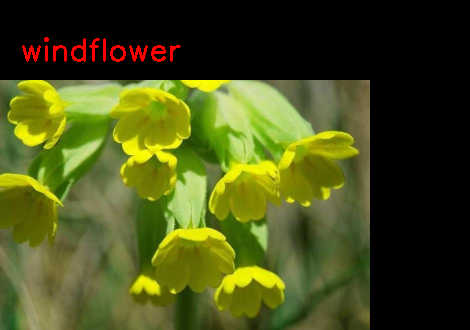

Class - daisy


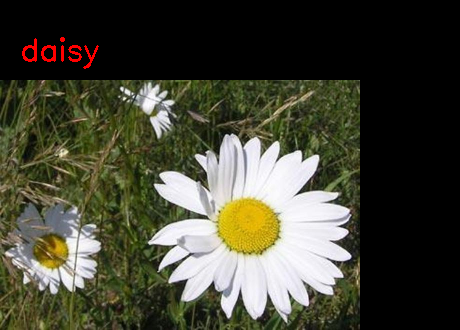

Class - cowslip


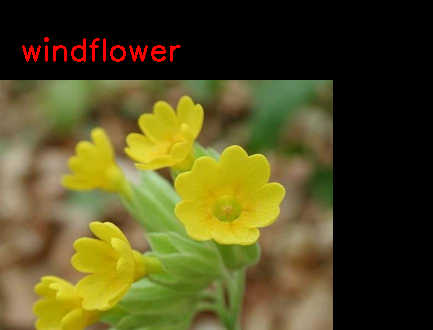

Class - tulip


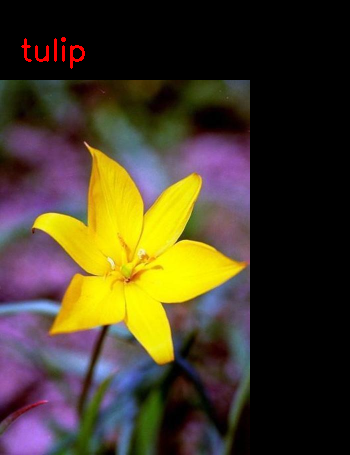

Class - buttercup


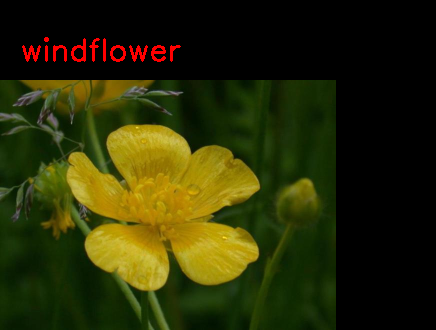

In [16]:
# Load Model
classifier = load_model('/content/drive/My Drive/Machine Learning/Models/flowers_vgg_16.h5')
folder_names = list(filter(lambda x: os.path.isdir(os.path.join(validation_data_dir + '/', x)), os.listdir(validation_data_dir + '/')))
folder_names.sort()
# print(folder_names)

flower_breeds_dict = {}
for i in range(len(folder_names)):
  key = '[{}]'.format(i)
  value = folder_names[i]
  flower_breeds_dict[key] = value
print(flower_breeds_dict)

def draw_test(name, pred, im):
    flower = flower_breeds_dict[str(pred)]
    BLACK = [0,0,0]
    expanded_image = cv2.copyMakeBorder(im, 80, 0, 0, 100 ,cv2.BORDER_CONSTANT,value=BLACK)
    cv2.putText(expanded_image, flower, (20, 60) , cv2.FONT_HERSHEY_SIMPLEX,1, (0,0,255), 2)
    cv2_imshow(expanded_image)
    
def getRandomImage(path):
    """function loads a random images from a random folder in our test path """
    folders = list(filter(lambda x: os.path.isdir(os.path.join(path, x)), os.listdir(path)))
    random_directory = np.random.randint(0,len(folders))
    path_class = folders[random_directory]
    print("Class - " + str(path_class))
    file_path = path + path_class
    file_names = [f for f in listdir(file_path) if isfile(join(file_path, f))]
    random_file_index = np.random.randint(0,len(file_names))
    image_name = file_names[random_file_index]
    return cv2.imread(file_path+"/"+image_name)


for i in range(0,50):
    input_im = getRandomImage(validation_data_dir + '/')
    input_original = input_im.copy()
    input_original = cv2.resize(input_original, None, fx=0.5, fy=0.5, interpolation = cv2.INTER_LINEAR)
    
    input_im = cv2.resize(input_im, (224, 224), interpolation = cv2.INTER_LINEAR)
    input_im = input_im / 255.
    input_im = input_im.reshape(1,224,224,3) 
    
    # Get Prediction
    res = np.argmax(classifier.predict(input_im, 1, verbose = 0), axis=1)
    
    # Show image with predicted class
    draw_test("Prediction", res, input_original)